# Padchest dataset analysis

https://bimcv.cipf.es/bimcv-projects/padchest/

In [1]:
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
import numpy as np
import random
from PIL import Image
from IPython.display import Image, display
pd.options.mode.chained_assignment = None
complete_metadata = pd.read_csv('PADCHEST_chest_x_ray_images_labels_160K_01.02.19.csv', low_memory=False)

## File selection
The dataset contains 160K images, distributed in 55 files. Due to limited amount of memory, the analysis will be conducted only on images from one selected file.

In [2]:
complete_metadata['ImageDir'].value_counts().head(5)

54    4297
40    3218
31    3218
22    3218
18    3218
Name: ImageDir, dtype: int64

In [3]:
metadata = complete_metadata[complete_metadata['ImageDir'] == 40]

## Metadata analysis

In [4]:
metadata.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 3218 entries, 128688 to 131905
Data columns (total 36 columns):
 #   Column                           Non-Null Count  Dtype  
---  ------                           --------------  -----  
 0   Unnamed: 0                       3218 non-null   int64  
 1   ImageID                          3218 non-null   object 
 2   ImageDir                         3218 non-null   int64  
 3   StudyDate_DICOM                  3218 non-null   int64  
 4   StudyID                          3218 non-null   object 
 5   PatientID                        3218 non-null   object 
 6   PatientBirth                     3216 non-null   float64
 7   PatientSex_DICOM                 3218 non-null   object 
 8   ViewPosition_DICOM               1989 non-null   object 
 9   Projection                       3218 non-null   object 
 10  MethodProjection                 3218 non-null   object 
 11  Pediatric                        3218 non-null   object 
 12  Modality_DICO

In [5]:
metadata.drop(['Unnamed: 0', 'ImageDir' ,'ViewPosition_DICOM'], axis = 1, inplace = True)

### Patients' age

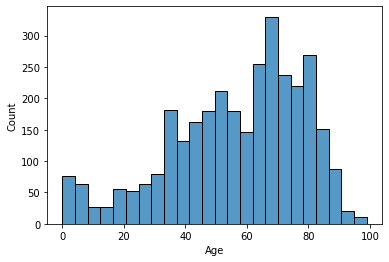

In [6]:
metadata['Age'] = pd.to_numeric(metadata['StudyDate_DICOM'].astype('string').str.slice(0,4)) - metadata['PatientBirth']
sns.histplot(metadata['Age'])
plt.show()

### Most common words in labels describing xrays

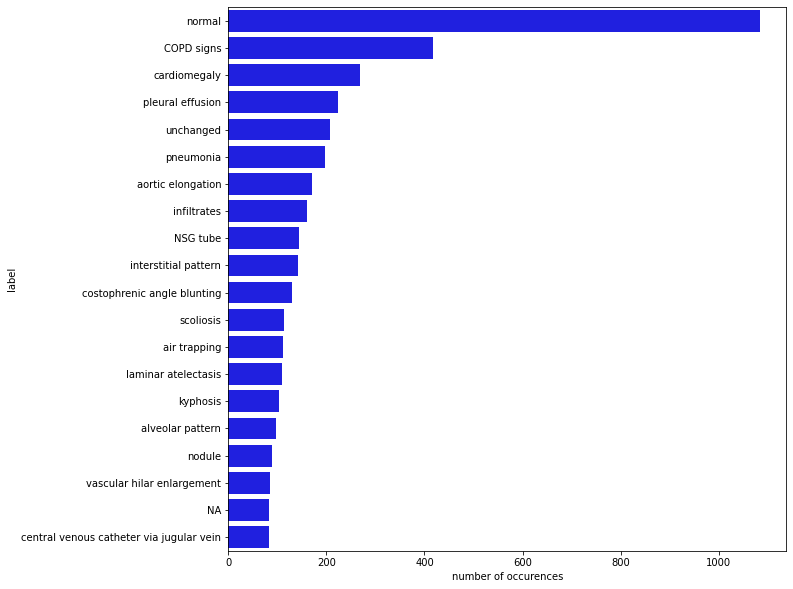

In [7]:
metadata['Labels'] = metadata['Labels'].astype('str')
metadata['Labels'].fillna('[""]', axis = 0,inplace = True)
labels = metadata['Labels'].tolist()
labels
for i,e in enumerate(labels):
    e = e.replace('\"', '')
    e = e.replace('\'', '')
    e = e.replace('[', '')
    labels[i] = e.replace(']', '')
labels = [y for x in labels for y in x.split(',')]
for i,e in enumerate(labels):
    labels[i] = e.strip()
labels = [[x,labels.count(x)] for x in set(labels)]
labels = pd.DataFrame(labels, columns=['label', 'number of occurences'])
labels.sort_values(by = 'number of occurences', inplace = True, ignore_index = True, ascending = False)
labels = labels.head(20)
labels.iloc[18,0] = 'NA'
plt.figure(figsize = (10,10))
sns.barplot(data=labels, y='label', x='number of occurences', color = 'blue')
plt.show()

### Most common diseases' localizations

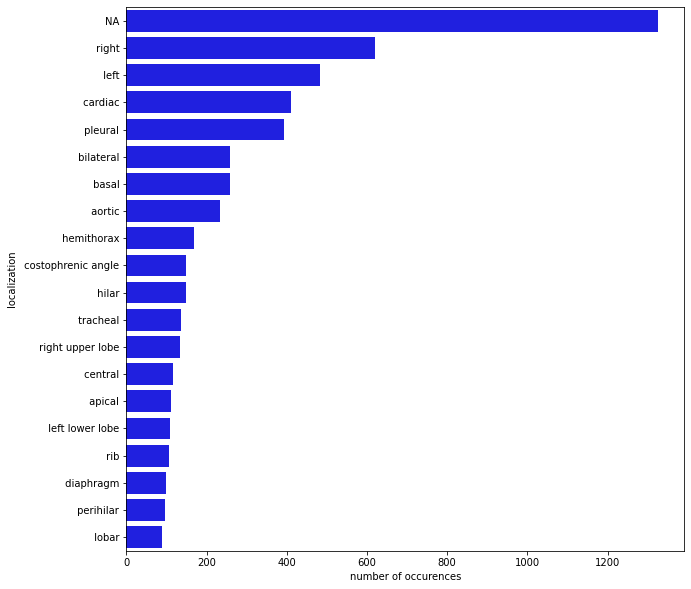

In [8]:
metadata['Localizations'] = metadata['Localizations'].astype('str')
metadata['Localizations'].fillna('[""]', axis = 0,inplace = True)
localizations = metadata['Localizations'].tolist()
for i,e in enumerate(localizations):
    e = e.replace('\"', '')
    e = e.replace('\'', '')
    e = e.replace('[', '')
    localizations[i] = e.replace(']', '')
localizations = [y for x in localizations for y in x.split(',')]
for i,e in enumerate(localizations):
    e = e.strip()
    localizations[i] = e.replace('loc', '')
localizations = [[x,localizations.count(x)] for x in set(localizations)]
localizations = pd.DataFrame(localizations, columns=['localization', 'number of occurences'])
localizations.sort_values(by = 'number of occurences', inplace = True, ignore_index = True, ascending = False)
localizations = localizations.head(20)
localizations.iloc[0,0] = 'NA'
plt.figure(figsize = (10,10))
sns.barplot(data=localizations, y='localization', x='number of occurences', color = 'blue')
plt.show()

### Projection types

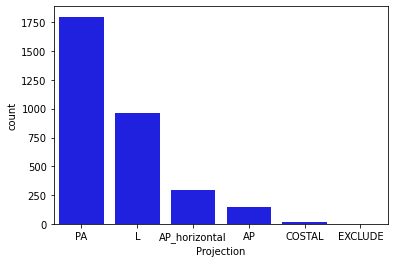

In [9]:
sns.countplot(data=metadata, x='Projection', color='blue')
plt.show()

### Correlation between the above values

#### Labels with itself

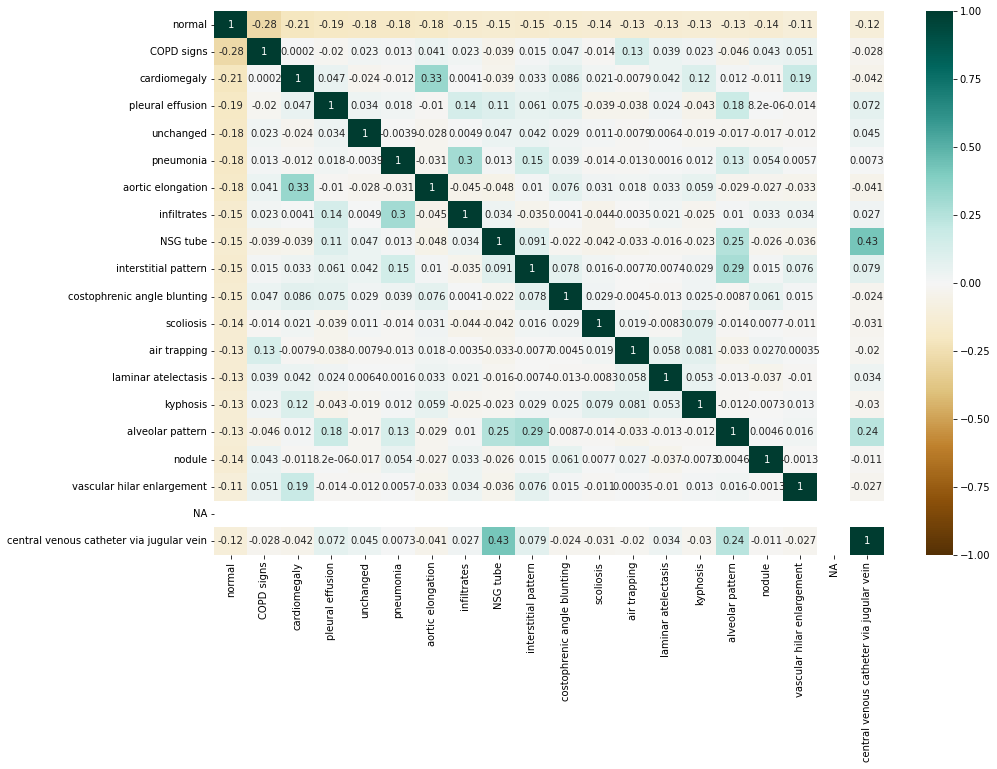

In [10]:
labels_list = labels['label'].tolist()
for label in labels_list:
    metadata[label] = metadata.apply(lambda x: 1 if label in str(x['Labels']) else 0, axis = 1)
    
plt.figure(figsize=(15, 10))
heatmap = sns.heatmap(metadata[labels_list].corr(), annot=True, vmin=-1, vmax=1, cmap="BrBG")
plt.show()

1. Label *normal* has only negative correlations with other labels, which makes sense
2. Biggest correlations:
    - NSG tube and central venous catherer via jugular vein (0.49)
    - aortic elongation and cardiomegaly (0.33)
    - infiltrates and pneumonia (0.30)
    - alveolar pattern and interstitial pattern (0.29)
    - alveolar pattern and NSG tube (0.25)

#### Labels with localization

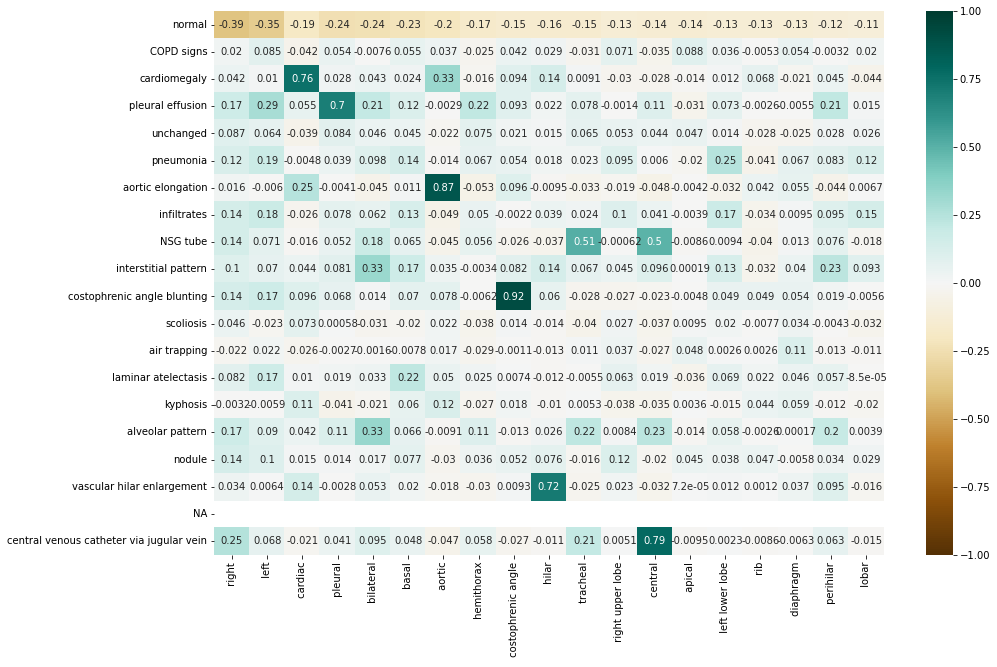

In [11]:
localizations_list = localizations['localization'].tolist()
for localization in localizations_list:
    metadata[localization] = metadata.apply(lambda x: 1 if localization in str(x['Localizations']) else 0, axis = 1)
    
plt.figure(figsize=(15, 10))
heatmap = sns.heatmap(metadata[labels_list + localizations_list].corr().iloc[:20,-19:], annot=True, vmin=-1, vmax=1, cmap="BrBG")
plt.show()

- Label *normal* with only negative correlations again
- Biggest correlations (mostly already implied by similar names):
    - costophrenic angle blunting and costophernic angle (0.92)
    - aortic elongation and aortic (0.87)
    - central venous catherer via jugular vein and central (0.79)
    - cardiomegaly and cardiac (0.76)

#### Labels with projection

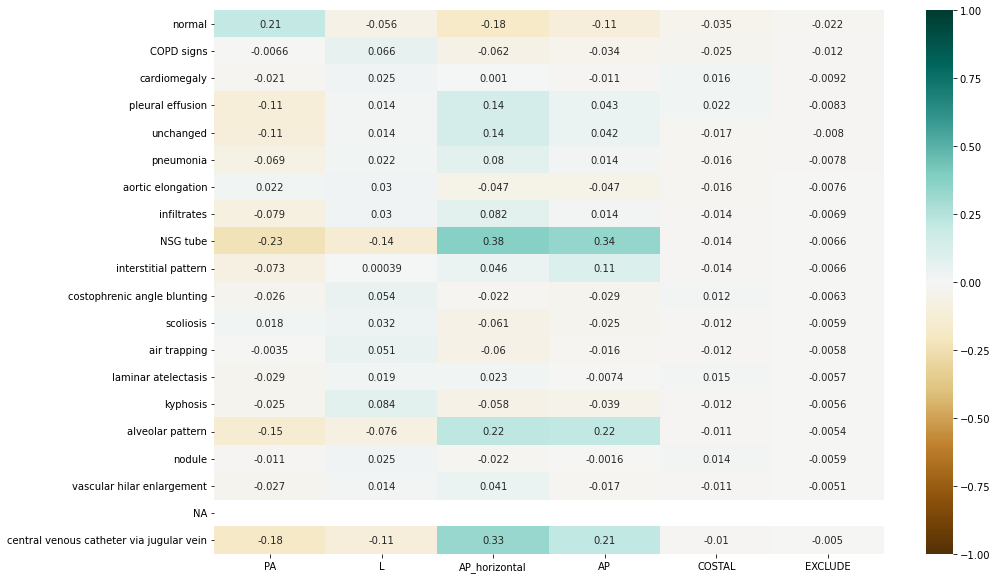

In [12]:
projections_list = metadata['Projection'].unique().tolist()
for projection in projections_list:
    metadata[projection] = metadata.apply(lambda x: 1 if projection == x['Projection'] else 0, axis = 1)
    
plt.figure(figsize=(15, 10))
heatmap = sns.heatmap(metadata[labels_list + projections_list].corr('pearson').iloc[:20 , -6:], annot=True, vmin=-1, vmax=1, cmap="BrBG")
plt.show()

## Images overwiev

### Images labeled normal

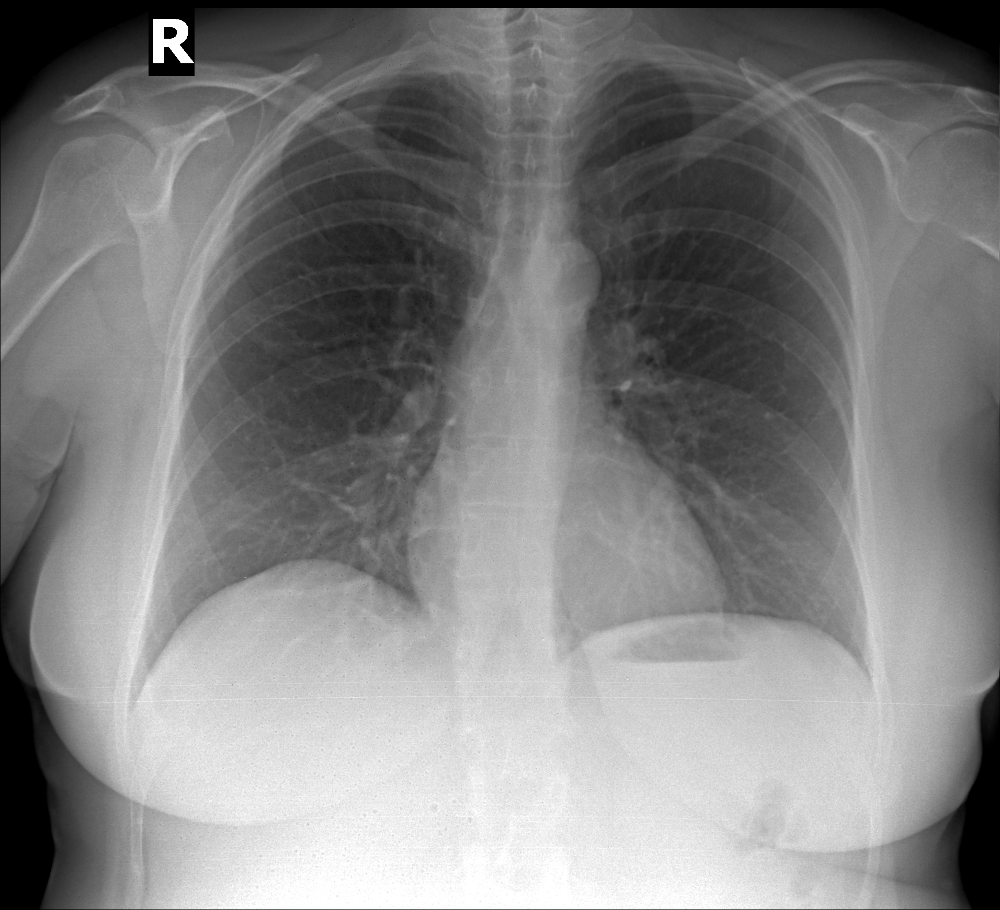

In [14]:
normal_images_ids = metadata[(metadata['Labels'] == "['normal']") & (metadata['Projection'] == "PA")].ImageID.tolist()
indexes = random.sample(range(1, len(normal_images_ids)), 1)
for i in range(1):
    display(Image(filename='./images/' + normal_images_ids[indexes[i]], width = 300))

### Images labelled with selected phrases

In [15]:
def show_images(disease, n):
    images_ids = metadata[(metadata['Labels'].str.contains(disease)) & (metadata['Projection'] == "PA")].ImageID.tolist()
    indexes = random.sample(range(1, len(images_ids)), n)
    for i in range(n):
        display(Image(filename='./images/' + images_ids[indexes[i]], width = 300))

#### COPD signs (pl. przewlekła obturacyjna choroba płuc)

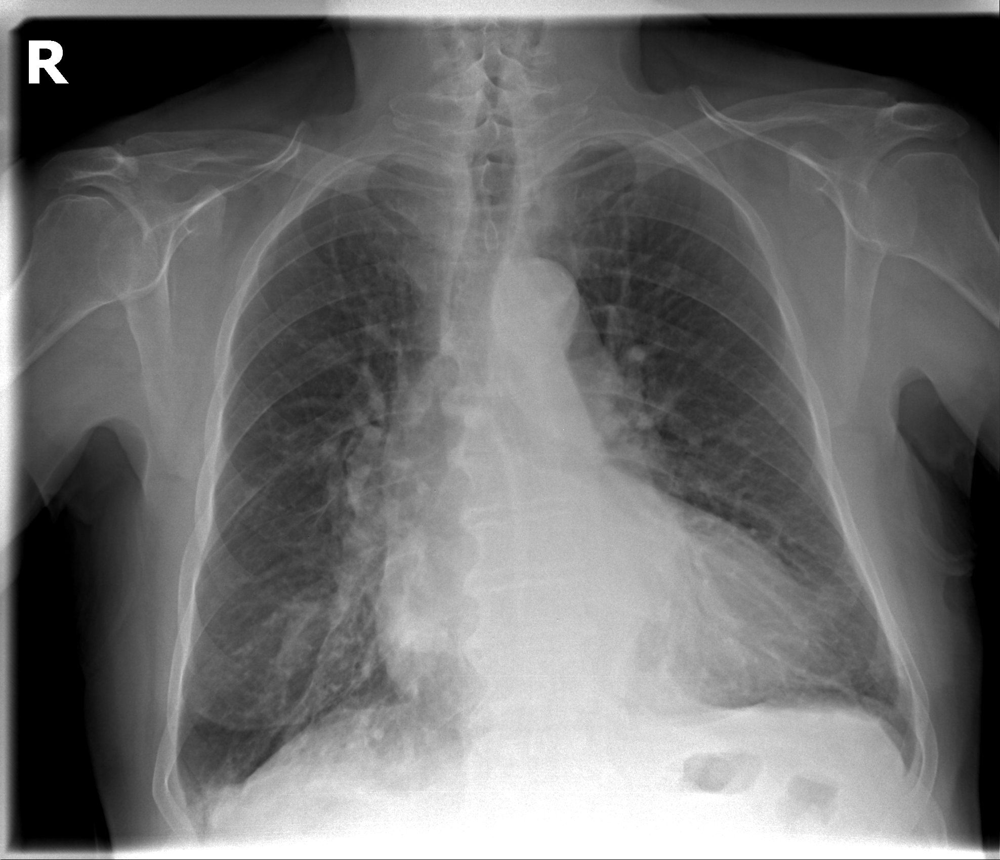

In [16]:
show_images('COPD signs', 1)

#### Cardiomegaly (pl. przerost serca)

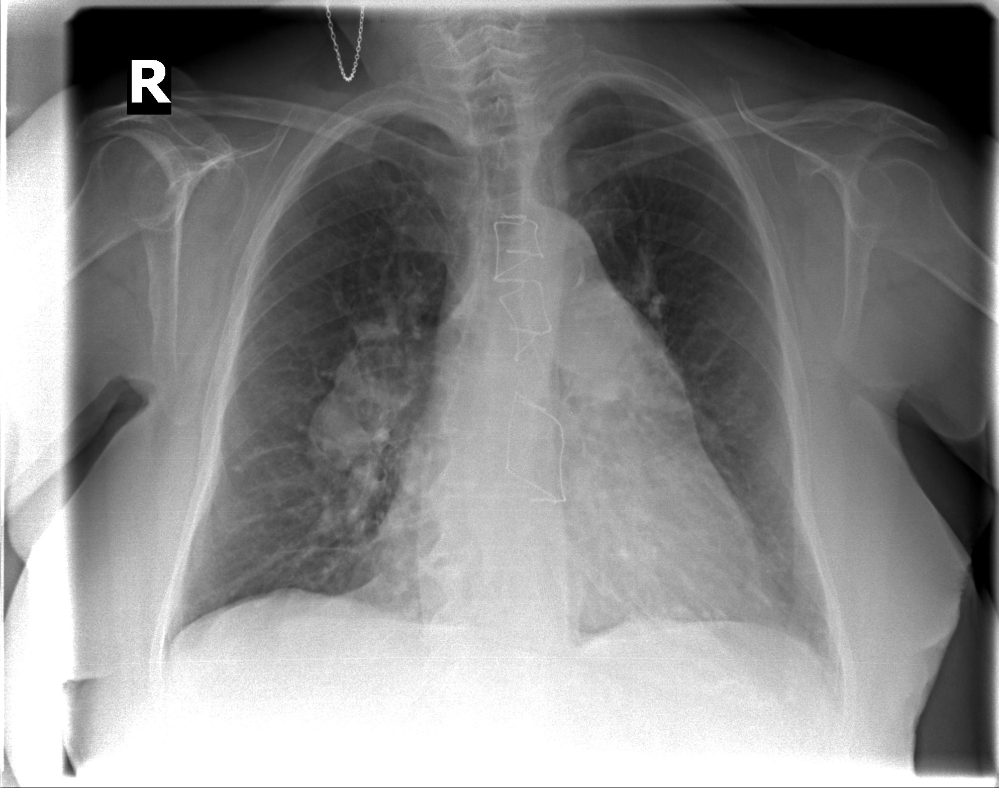

In [17]:
show_images('cardiomegaly', 1)

#### Pleural effusion (pl. wysięk opłucnowy)

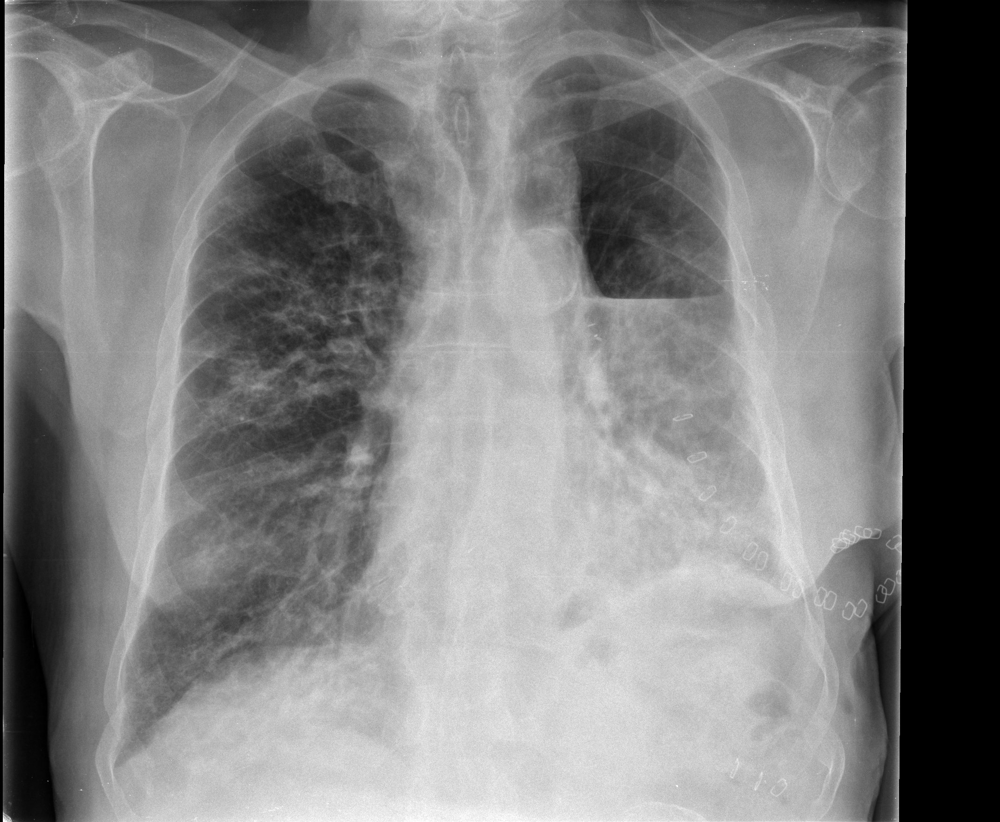

In [18]:
show_images('pleural effusion', 1)

#### Pneumonia (pl. zapalenie płuc)

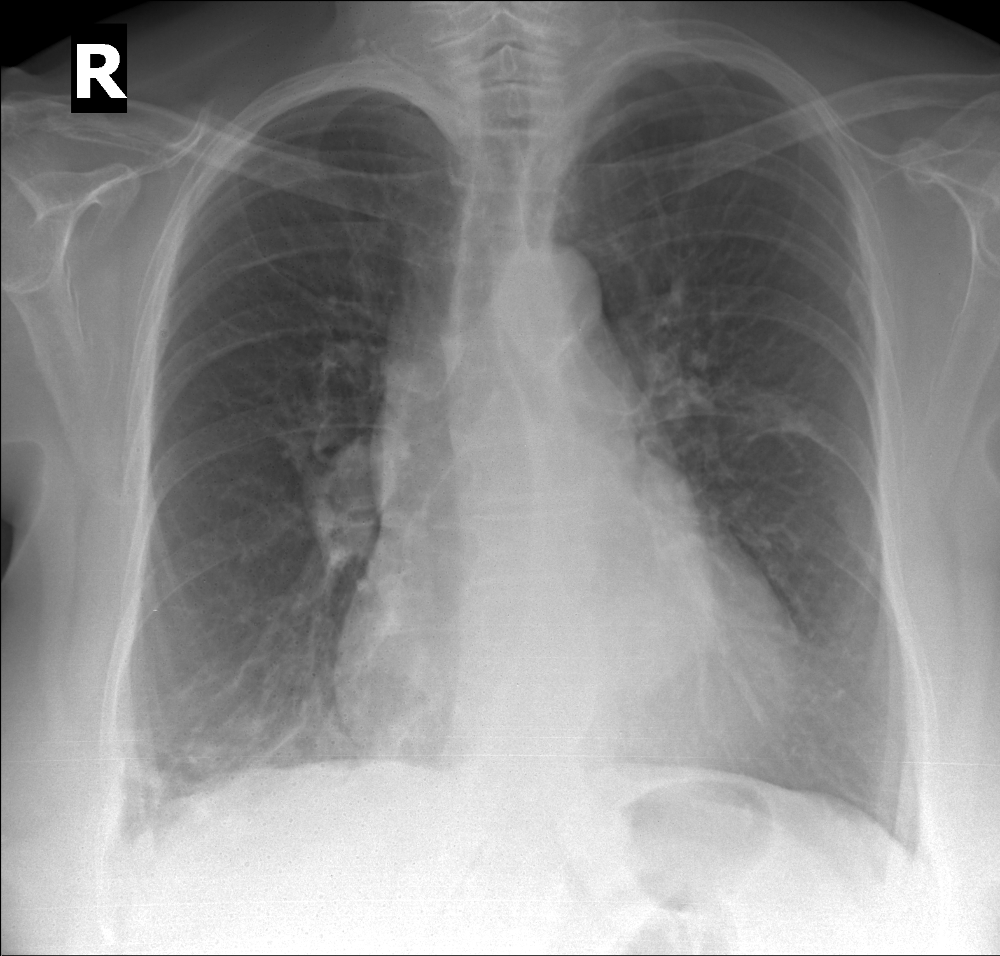

In [19]:
show_images('pneumonia', 1)

- Even in the same category the images were taken from slightly different angles, which could be problematic (I think)
- There are white 'R's in the majority of images, which might influence the model.
- I wanted to show more images from each category but the file size would become too big then.